In [ ]:
# thư viện
import json
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import cv2

Thư mục ảnh kết quả: https://drive.google.com/drive/folders/1uvrVq-B4pTbtjU9yjxNcD3JAUE49yN8I?usp=sharing

# Multimatch

In [ ]:
# đường dẫn đến file
path_MultiMatch = "/content/drive/MyDrive/3rdYear/DoAnKHDL/result/multimatch.json"
# load file
with open(path_MultiMatch, 'r') as file:
    report = json.load(file)

In [ ]:
# load vào data frame
keys = [list(item.keys())[0] for item in report]
score_shape = [list(item.values())[0][0] for item in report]
score_length = [list(item.values())[0][1] for item in report]
score_direction = [list(item.values())[0][2] for item in report]
score_position = [list(item.values())[0][3] for item in report]

df = pd.DataFrame({'key': keys, 'shape': score_shape, 
                   'length': score_length, 'direction': score_direction, 'position': score_position})
# tách lấy task
df['task'] = [s.split('_')[0] for s in df['key']]
df.head()

,key,shape,length,direction,position,task
0,bottle_000000037367.jpg,0.900670,0.710677,0.842411,0.955206,bottle
1,bottle_000000086135.jpg,0.928513,0.579093,0.936122,0.701807,bottle
2,bottle_000000122602.jpg,0.949421,0.903104,0.911661,0.935637,bottle
3,bottle_000000137967.jpg,0.878042,0.700690,0.848457,0.938625,bottle
4,bottle_000000138086.jpg,0.870337,0.726642,0.878021,0.888345,bottle


In [ ]:
df.describe()


,shape,length,direction,position
count,6110.000000,6110.000000,6110.000000,6110.000000
mean,0.893566,0.706953,0.876627,0.898973
std,0.051287,0.156044,0.062438,0.075798
min,0.669687,0.147231,0.513340,0.486248
25%,0.863804,0.594477,0.846184,0.861471
50%,0.902175,0.720829,0.888734,0.925677
75%,0.930739,0.832737,0.919209,0.953773
max,0.990630,0.989586,0.989377,0.990630


In [ ]:
aspects = ['shape','length', 'direction', 'position']
shape, length, direction, position = [], [], [], []
shape.append(df.describe()['shape']['min'])
shape.append(df.describe()['shape']['max'])
length.append(df.describe()['length']['min'])
length.append(df.describe()['length']['max'])
direction.append(df.describe()['direction']['min'])
direction.append(df.describe()['direction']['max'])
position.append(df.describe()['position']['min'])
position.append(df.describe()['position']['max'])
multi_match_global_df = pd.DataFrame({'key': ['min', 'max'],aspects[0]: shape, aspects[1]: length,
                                      aspects[2]: direction, aspects[3]: position})
multi_match_global_df.to_excel('multi_match_global_df.xlsx')
multi_match_global_df

,key,shape,length,direction,position
0,min,0.669687,0.147231,0.513340,0.486248
1,max,0.990630,0.989586,0.989377,0.990630


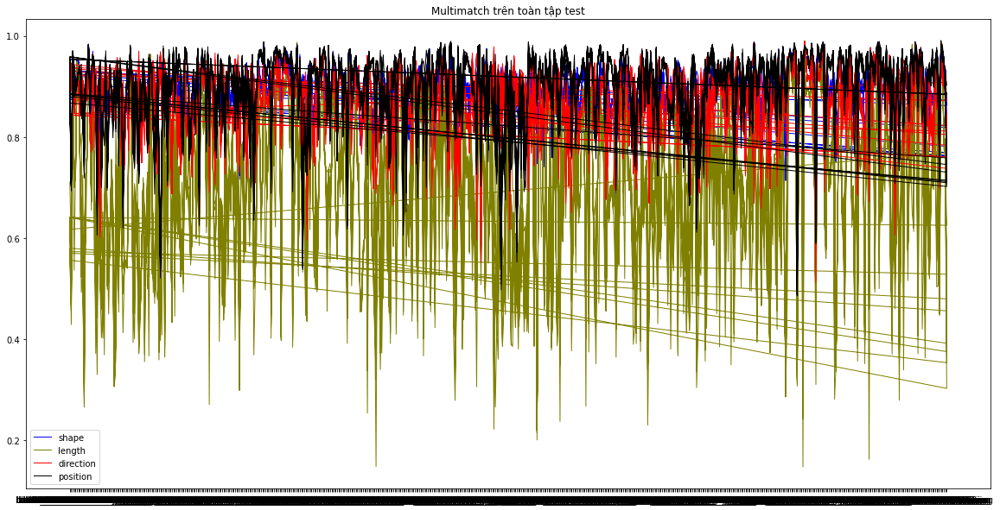

In [ ]:
fig = plt.figure(figsize=(20, 10))
plt.plot('key', 'shape', data=df, color='blue', linewidth=1)
plt.plot('key', 'length', data=df, color='olive', linewidth=1)
plt.plot('key', 'direction', data=df, color='red', linewidth=1)
plt.plot('key', 'position', data=df, color='black', linewidth=1)

# show legend
plt.legend()
plt.title("Multimatch trên toàn tập test")

# show graph
plt.show()

## global shape best/worst

In [ ]:
# quan sát worst
worst_shape = df.loc[df['shape'] <= df.describe()['shape']["25%"]]
print("25% ({} điểm dữ liệu) dự đoán test của mô hình là dưới {}."\
      .format(len(worst_shape), round(df.describe()['shape']["25%"], 3)))
print("{} điểm dữ liệu < 0.7".format(len(df.loc[df['shape'] <= 0.7])))
print("{} điểm dữ liệu < 0.8, chiếm {:.2f}"\
      .format(len(df.loc[df['shape'] <= 0.8]), len(df.loc[df['shape'] <= 0.8]) / len(df)))
global_shape_smaller_than_70percent = df.loc[df['shape'] <= 0.7]['key']
print("Các điểm dữ liệu có shape < 0.8 là:\n", '\t '.join(global_shape_smaller_than_70percent))
global_shape_smaller_than_80percent = df.loc[df['shape'] <= 0.8]['key']
print("Các điểm dữ liệu có shape < 0.8 là:\n", '\t '.join(global_shape_smaller_than_80percent))

25% (1528 điểm dữ liệu) dự đoán test của mô hình là dưới 0.864.
8 điểm dữ liệu < 0.7
324 điểm dữ liệu < 0.8, chiếm 0.05
Các điểm dữ liệu có shape < 0.8 là:
 mouse_000000218494.jpg	 stop sign_000000515670.jpg	 mouse_000000218494.jpg	 mouse_000000218494.jpg	 mouse_000000218494.jpg	 fork_000000484280.jpg	 keyboard_000000487002.jpg	 mouse_000000218494.jpg
Các điểm dữ liệu có shape < 0.8 là:
 bottle_000000253489.jpg	 bottle_000000394517.jpg	 bowl_000000042526.jpg	 bowl_000000105711.jpg	 car_000000293785.jpg	 chair_000000402786.jpg	 chair_000000576067.jpg	 cup_000000526536.jpg	 cup_000000527219.jpg	 fork_000000561517.jpg	 knife_000000234499.jpg	 laptop_000000024721.jpg	 laptop_000000102446.jpg	 laptop_000000195538.jpg	 laptop_000000426205.jpg	 microwave_000000561783.jpg	 mouse_000000218494.jpg	 oven_000000221753.jpg	 potted plant_000000340175.jpg	 potted plant_000000497928.jpg	 sink_000000338159.jpg	 sink_000000429598.jpg	 sink_000000555939.jpg	 toilet_000000024845.jpg	 toilet_000000152298.j

Những scanpath < 0.7


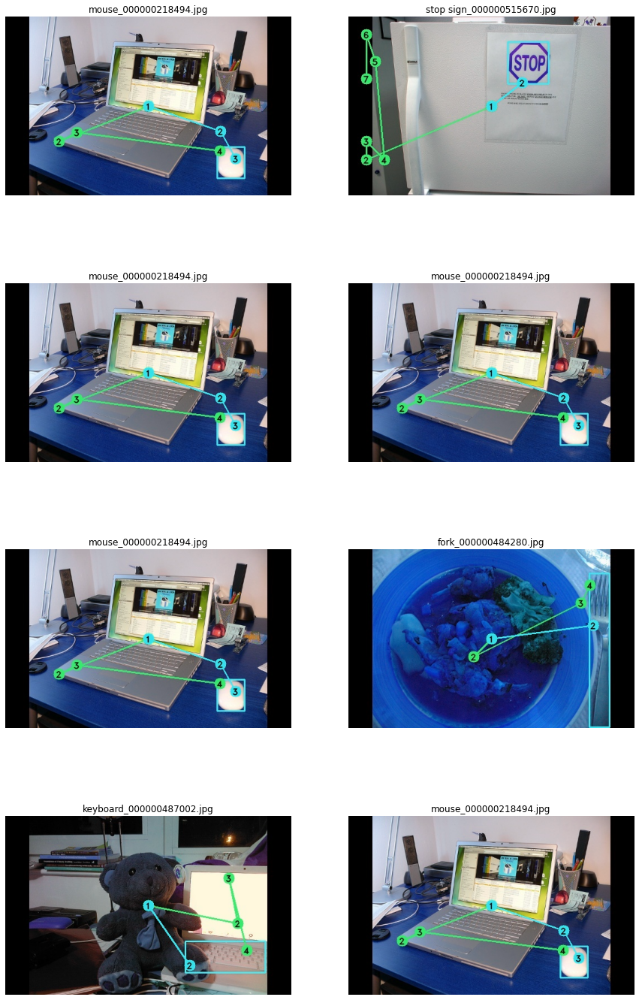

In [ ]:
print('Những scanpath có shape < 0.7')
fig = plt.figure(figsize=(15, 25))
rows = 4
columns = 2
result_path = "/content/drive/MyDrive/3rdYear/DoAnKHDL/result/"
subplot_count=1
for img in global_shape_smaller_than_70percent:
  fig.add_subplot(rows, columns, subplot_count)
  plt.imshow(cv2.imread(result_path+img.replace('_', '/')))
  plt.axis('off')
  plt.title(img)
  subplot_count = subplot_count + 1

tv_000000546934.jpg


Text(0.5, 1.0, 'Best global shape.')

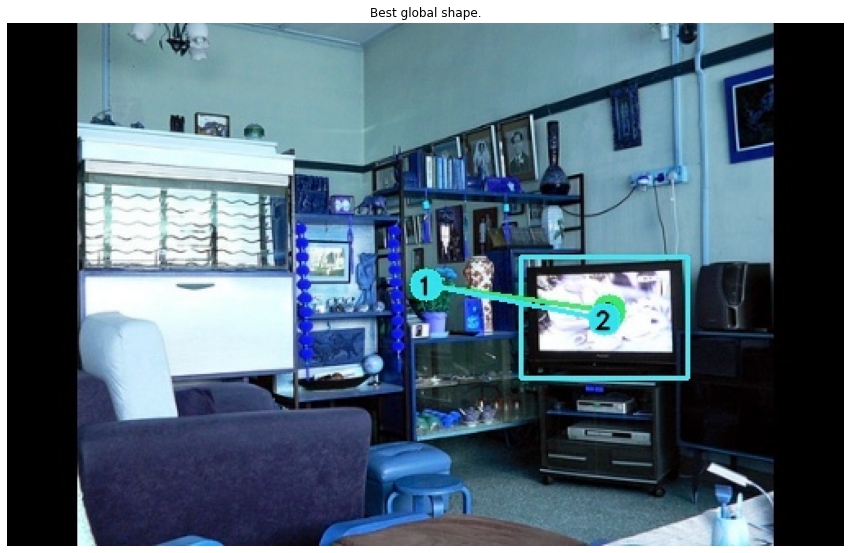

In [ ]:
fig = plt.figure(figsize=(15, 10))
print(list(df.loc[df['shape'] == df.describe()['shape']['max']]['key'])[0])
result_path = "/content/drive/MyDrive/3rdYear/DoAnKHDL/result/"
best_global_shape = result_path + list(df.loc[df['shape'] == df.describe()['shape']['max']]['key'])[0].replace('_', '/')
fig.add_subplot(1, 1, 1)
plt.imshow(cv2.imread(best_global_shape))
plt.axis('off')
plt.title('Best global shape.')

keyboard_000000487002.jpg


Text(0.5, 1.0, 'Worst global shape.')

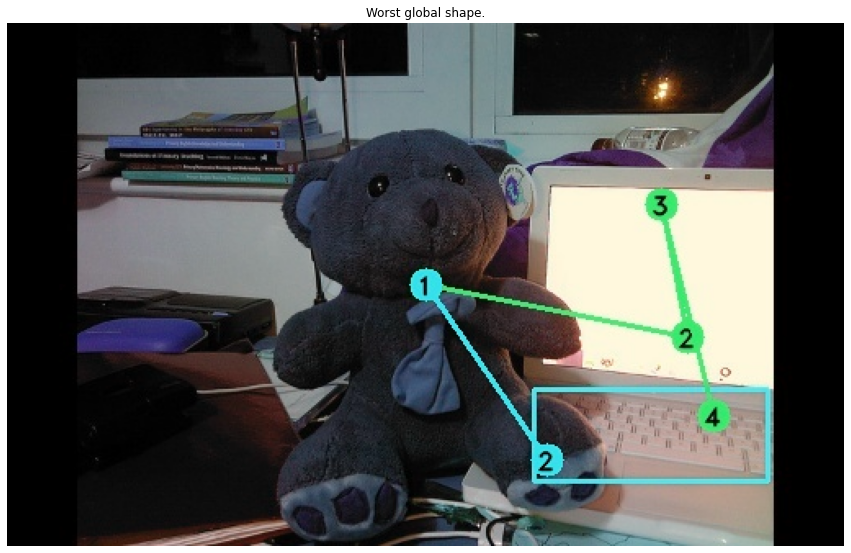

In [ ]:
fig = plt.figure(figsize=(15, 10))
print(list(df.loc[df['shape'] == df.describe()['shape']['min']]['key'])[0])
result_path = "/content/drive/MyDrive/3rdYear/DoAnKHDL/result/"
worst_global_shape = result_path + list(df.loc[df['shape'] == df.describe()['shape']['min']]['key'])[0].replace('_', '/')
fig.add_subplot(1, 1, 1)
plt.imshow(cv2.imread(worst_global_shape))
plt.axis('off')
plt.title('Worst global shape.')

## global length, dir, pos best/worst

In [ ]:
aspects = ['length', 'direction', 'position']
for a in aspects:
  global_worst = df.loc[df[a] <= df.describe()[a]["25%"]]
  print("25% ({} điểm dữ liệu) dự đoán test của mô hình {} dưới {}."\
        .format(len(global_worst), a, round(df.describe()[a]["25%"], 3)))
  print("{} điểm dữ liệu < 0.7".format(len(df.loc[df[a] <= 0.7])))
  print("{} điểm dữ liệu < 0.8, chiếm {:.2f}"\
        .format(len(df.loc[df[a] <= 0.8]), len(df.loc[df[a] <= 0.8]) / len(df)))
  global_smaller_than_70percent = df.loc[df[a] <= 0.7]['key']
  print("Các điểm dữ liệu có {} < 0.7 là:\n".format(a), '\t '.join(global_smaller_than_70percent))
  global_smaller_than_80percent = df.loc[df[a] <= 0.8]['key']
  print("Các điểm dữ liệu có {} < 0.8 là:\n".format(a), '\t '.join(global_smaller_than_70percent))
  print()

25% (1529 điểm dữ liệu) dự đoán test của mô hình length dưới 0.594.
2774 điểm dữ liệu < 0.7
4173 điểm dữ liệu < 0.8, chiếm 0.68
Các điểm dữ liệu có length < 0.7 là:
 bottle_000000086135.jpg	 bottle_000000225129.jpg	 bottle_000000231822.jpg	 bottle_000000253489.jpg	 bottle_000000298773.jpg	 bottle_000000303670.jpg	 bottle_000000319696.jpg	 bottle_000000325992.jpg	 bottle_000000394517.jpg	 bottle_000000426253.jpg	 bottle_000000433505.jpg	 bottle_000000476851.jpg	 bottle_000000478155.jpg	 bottle_000000520012.jpg	 bottle_000000547875.jpg	 bottle_000000575834.jpg	 bottle_000000581205.jpg	 bowl_000000019589.jpg	 bowl_000000042526.jpg	 bowl_000000050829.jpg	 bowl_000000105711.jpg	 bowl_000000113040.jpg	 bowl_000000138397.jpg	 bowl_000000209145.jpg	 bowl_000000221620.jpg	 bowl_000000256899.jpg	 bowl_000000263393.jpg	 bowl_000000268254.jpg	 bowl_000000318044.jpg	 bowl_000000335515.jpg	 bowl_000000355430.jpg	 bowl_000000369185.jpg	 bowl_000000377359.jpg	 bowl_000000410889.jpg	 bowl_000000478155.

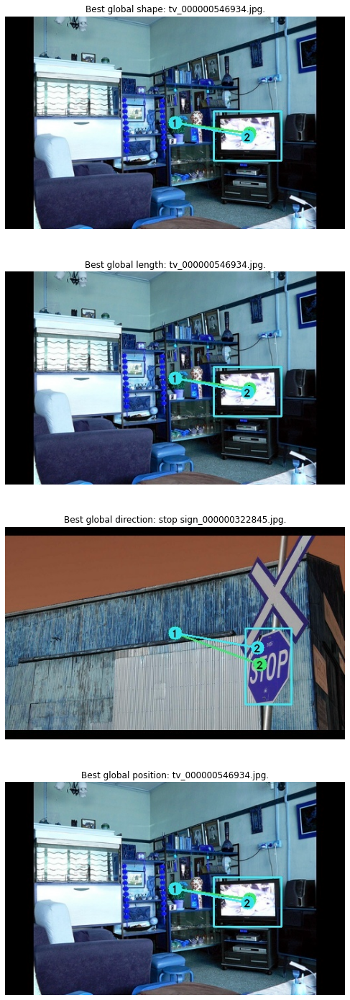

In [ ]:
fig = plt.figure(figsize=(40, 25))
aspects = ['shape', 'length', 'direction', 'position']
result_path = "/content/drive/MyDrive/3rdYear/DoAnKHDL/result/"
subplot_count = 1
for a in aspects:
  # print("File:", list(df.loc[df[a] == df.describe()[a]['max']]['key'])[0])
  best_global_shape = result_path + list(df.loc[df[a] == df.describe()[a]['max']]['key'])[0].replace('_', '/')
  fig.add_subplot(4, 1, subplot_count)
  plt.imshow(cv2.imread(best_global_shape))
  plt.axis('off')
  plt.title('Best global {}: {}.'.format(a, list(df.loc[df[a] == df.describe()[a]['max']]['key'])[0]))
  subplot_count = subplot_count + 1

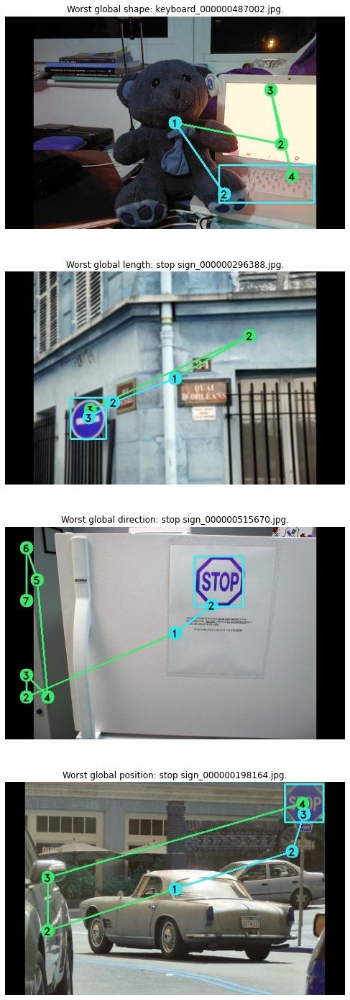

In [ ]:
fig = plt.figure(figsize=(40, 25))
aspects = ['shape', 'length', 'direction', 'position']
result_path = "/content/drive/MyDrive/3rdYear/DoAnKHDL/result/"
subplot_count = 1
for a in aspects:
  # print("File:", list(df.loc[df[a] == df.describe()[a]['max']]['key'])[0])
  fig.add_subplot(4, 1, subplot_count)
  filename = list(df.loc[df[a] == df.describe()[a]['min']]['key'])[0]
  worst_global = result_path + filename.replace('_', '/')
  plt.imshow(cv2.imread(worst_global))
  plt.axis('off')
  plt.title('Worst global {}: {}.'.format(a, filename))
  subplot_count = subplot_count + 1

## local best/worst

In [ ]:
categories = list(df['task'].unique())
print(len(categories))
print(categories)

18
['bottle', 'bowl', 'car', 'chair', 'clock', 'cup', 'fork', 'keyboard', 'knife', 'laptop', 'microwave', 'mouse', 'oven', 'potted plant', 'sink', 'stop sign', 'toilet', 'tv']


In [ ]:
shape_min, shape_max = [], []
length_min, length_max = [], []
direction_min, direction_max = [], []
position_min, position_max = [], []
for cat in categories:
  local_df = df.loc[df['task'] == cat]
  # print("Nhóm :", cat)
  shape_min.append(round(local_df.describe()['shape']['min'], 3))
  shape_max.append(round(local_df.describe()['shape']['max'], 3))
  length_min.append(round(local_df.describe()['length']['min'], 3))
  length_max.append(round(local_df.describe()['length']['max'], 3))
  direction_min.append(round(local_df.describe()['direction']['min'], 3))
  direction_max.append(round(local_df.describe()['direction']['max'], 3))
  position_min.append(round(local_df.describe()['position']['min'], 3))
  position_max.append(round(local_df.describe()['position']['max'], 3))
multi_match_local_df = pd.DataFrame({'Key': categories, 'shape_min': shape_min, 'shape_max': shape_max,
                                     'length_min': length_min, 'length_max': length_max, 
                                     'direction_min': direction_min, 'direction_max': direction_max,
                                     'position_min': position_min, 'position_max': position_max})
multi_match_local_df

,Key,shape_min,shape_max,length_min,length_max,direction_min,direction_max,position_min,position_max
0,bottle,0.737,0.983,0.265,0.972,0.601,0.983,0.605,0.983
1,bowl,0.748,0.978,0.356,0.964,0.735,0.971,0.620,0.982
2,car,0.736,0.973,0.359,0.963,0.688,0.972,0.521,0.980
3,chair,0.716,0.973,0.271,0.955,0.638,0.966,0.625,0.979
4,clock,0.806,0.988,0.398,0.986,0.776,0.985,0.688,0.988
5,cup,0.747,0.984,0.254,0.987,0.596,0.978,0.538,0.984
6,fork,0.681,0.975,0.148,0.964,0.665,0.965,0.605,0.978
7,keyboard,0.670,0.987,0.279,0.970,0.553,0.983,0.702,0.989
8,knife,0.702,0.948,0.222,0.907,0.616,0.978,0.498,0.964
9,laptop,0.741,0.971,0.201,0.941,0.692,0.957,0.759,0.988


In [ ]:
def max_value_in_column(column):    
  bold = 'font-weight: bold'
  default = ''
  maximum_in_column = column.max()
  return [bold if v == maximum_in_column else default for v in column]
def min_value_in_column(column):    
  bold = 'font-weight: bold'
  default = ''
  minimum_in_column = column.min()
  return [bold if v == minimum_in_column else default for v in column]

multi_match_local_df = multi_match_local_df.style.apply(min_value_in_column, 
               subset=['shape_min', 'length_min', 'direction_min', 'position_min'], axis=0).highlight_max()
# multi_match_local_df = multi_match_local_df.style.apply(max_value_in_column, 
#                subset=['shape_max', 'length_max', 'direction_max', 'position_max'], axis=0)
multi_match_local_df

,Key,shape_min,shape_max,length_min,length_max,direction_min,direction_max,position_min,position_max
0,bottle,0.737000,0.983000,0.265000,0.972000,0.601000,0.983000,0.605000,0.983000
1,bowl,0.748000,0.978000,0.356000,0.964000,0.735000,0.971000,0.620000,0.982000
2,car,0.736000,0.973000,0.359000,0.963000,0.688000,0.972000,0.521000,0.980000
3,chair,0.716000,0.973000,0.271000,0.955000,0.638000,0.966000,0.625000,0.979000
4,clock,0.806000,0.988000,0.398000,0.986000,0.776000,0.985000,0.688000,0.988000
5,cup,0.747000,0.984000,0.254000,0.987000,0.596000,0.978000,0.538000,0.984000
6,fork,0.681000,0.975000,0.148000,0.964000,0.665000,0.965000,0.605000,0.978000
7,keyboard,0.670000,0.987000,0.279000,0.970000,0.553000,0.983000,0.702000,0.989000
8,knife,0.702000,0.948000,0.222000,0.907000,0.616000,0.978000,0.498000,0.964000
9,laptop,0.741000,0.971000,0.201000,0.941000,0.692000,0.957000,0.759000,0.988000


In [ ]:
multi_match_local_df.to_excel("multi_match_local_df.xlsx", index=False)

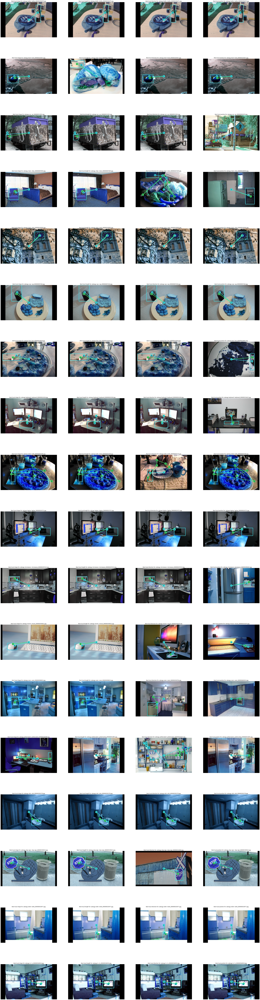

In [ ]:
fig = plt.figure(figsize=(50, 200))
aspects = ['shape', 'length', 'direction', 'position']
result_path = "/content/drive/MyDrive/3rdYear/DoAnKHDL/result/"
subplot_count = 1
for cat in categories:
  local_df = df.loc[df['task'] == cat]
  for a in aspects:
    filename = list(local_df.loc[local_df[a] == local_df.describe()[a]['max']]['key'])[0]
    best_local = result_path + filename.replace('_', '/')
    fig.add_subplot(18, 4, subplot_count)
    plt.imshow(cv2.imread(best_local))
    plt.axis('off')
    plt.title('Best local {} for cateogy {}: {}.'.format(a, cat, filename))
    subplot_count = subplot_count + 1

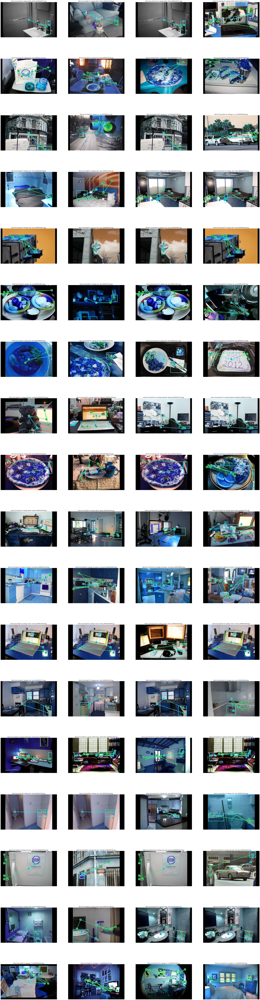

In [ ]:
fig = plt.figure(figsize=(50, 200))
aspects = ['shape', 'length', 'direction', 'position']
result_path = "/content/drive/MyDrive/3rdYear/DoAnKHDL/result/"
subplot_count = 1
for cat in categories:
  local_df = df.loc[df['task'] == cat]
  for a in aspects:
    filename = list(local_df.loc[local_df[a] == local_df.describe()[a]['min']]['key'])[0]
    best_local = result_path + filename.replace('_', '/')
    fig.add_subplot(18, 4, subplot_count)
    plt.imshow(cv2.imread(best_local))
    plt.axis('off')
    plt.title('Worst local {} for cateogy {}: {}.'.format(a, cat, filename))
    subplot_count = subplot_count + 1